In [1]:
%load_ext autoreload
%autoreload 2
#%matplotlib notebook

In [2]:
levir_root = "/mnt/store_dai/datasrc/dchan/levir-cd"
final_levir_root = "/mnt/stores/store-DAI/datasrc/dchan/levir-cd"

In [3]:
import sys
sys.path.append("..")

In [4]:
import glob
from pathlib import Path
import csv
from matplotlib import pyplot as plt
#plt.ioff()

import odeon
from odeon.data.data_module import Input


In [5]:
levir_path = Path(levir_root)
final_levir_path = Path(final_levir_root)

In [7]:
cur_levir_path = levir_path #"/mnt/store_dai/datasrc/dchan/levir-cd-repatched-256x256"

for dir in cur_levir_path.iterdir():
    if (dir.is_dir()):
        stage = dir.name
        with open(levir_path / f'{stage}.csv', 'w', newline='') as csvfile:
            fieldnames = ['A', 'B', 'label']
            writer = csv.DictWriter(csvfile, fieldnames=fieldnames)

            writer.writeheader()
            for label in (dir/"label").iterdir():
                label_name = label.name
                [filename, ext] = os.path.splitext(label_name)
                if (ext == ".png"):
                    print(f"checking {label_name}")
                    assert (dir / "A" / label_name).exists()
                    #A = final_levir_path / "A" / label_name
                    assert (dir / "B" / label_name).exists()
                    #B = final_levir_path / "B" / label_name

                    writer.writerow({
                        'A': Path(stage) / "A" / label_name,
                        'B': Path(stage) / "B" / label_name,
                        'label': Path(stage) / "label" / label_name
                    })

In [6]:
batch_size = 10
num_workers = 8

train_params = {
    'input_fields': {
        "T0": {"name": "A", "type": "raster", "dtype": "uint8", "band_indices": [1, 2, 3]},
        "T1": {"name": "B", "type": "raster", "dtype": "uint8", "band_indices": [1, 2, 3]},
        "mask": {"name": "label", "type": "mask", "encoding": "integer"}
    },
    'dataloader_options' : {"batch_size": batch_size, "num_workers": num_workers},
    'input_file': levir_path / "train.csv",
    'input_files_has_header': 'infer',
    'root_dir': levir_path,
    'nb_samples': 0,
    'sample_seed': 0
}

val_params = {
    'input_fields': {
        "T0": {"name": "A", "type": "raster", "dtype": "uint8", "band_indices": [1, 2, 3]},
        "T1": {"name": "B", "type": "raster", "dtype": "uint8", "band_indices": [1, 2, 3]},
        "mask": {"name": "label", "type": "mask", "encoding": "integer"}
    },
    'dataloader_options' : {"batch_size": batch_size, "num_workers": num_workers},
    'input_file': levir_path / "val.csv",
    'input_files_has_header': 'infer',
    'root_dir': levir_path,
    'nb_samples': 0,
    'sample_seed': 0
}

test_params = {
    'input_fields': {
        "T0": {"name": "A", "type": "raster", "dtype": "uint8", "band_indices": [1, 2, 3]},
        "T1": {"name": "B", "type": "raster", "dtype": "uint8", "band_indices": [1, 2, 3]},
        "mask": {"name": "label", "type": "mask", "encoding": "integer"}
    },
    'dataloader_options' : {"batch_size": batch_size, "num_workers": num_workers},
    'input_file': levir_path / "test.csv",
    'root_dir': levir_path,
    'input_files_has_header': 'infer',
    'nb_samples': 0,
    'sample_seed': 0
}


input = Input(
    fit_params=train_params,
    validate_params=val_params,
    test_params=test_params
)


In [7]:
input.prepare_data()
input.setup(stage="fit")

In [8]:
def image_line(list_images, col_titles):
    # Create a figure to contain the plot.
    figure = plt.figure(figsize=(3 * len(col_titles), 3))
    for i, title in enumerate(col_titles):
        # Start next subplot.
        plt.subplot(1, len(col_titles), i + 1, title=title)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        img = list_images[i].detach().cpu().permute(1, 2, 0).numpy()
        plt.imshow(img, interpolation='nearest', vmin=0, vmax=255)
        plt.tight_layout()

    return figure


/tmp/ipykernel_66627/534104989.py:12: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_66627/534104989.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  figure = plt.figure(figsize=(3 * len(col_titles), 3))


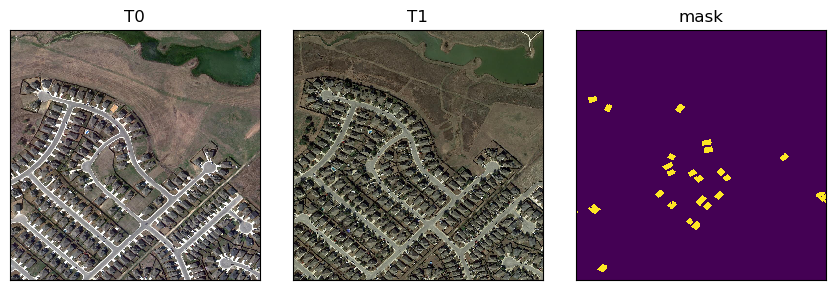

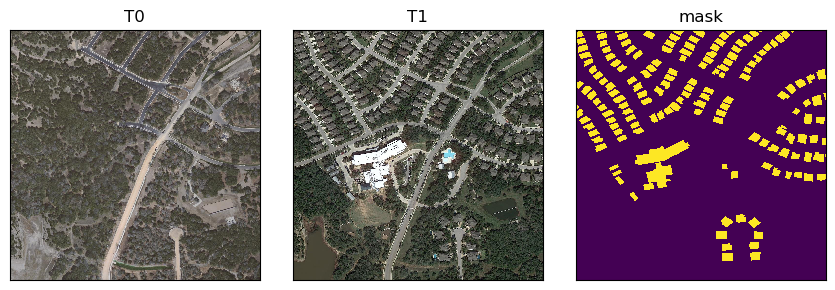

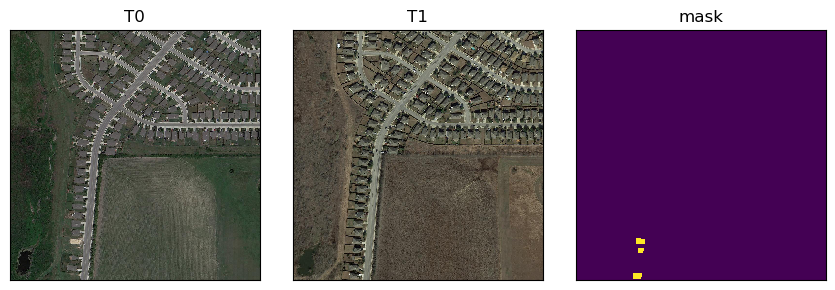

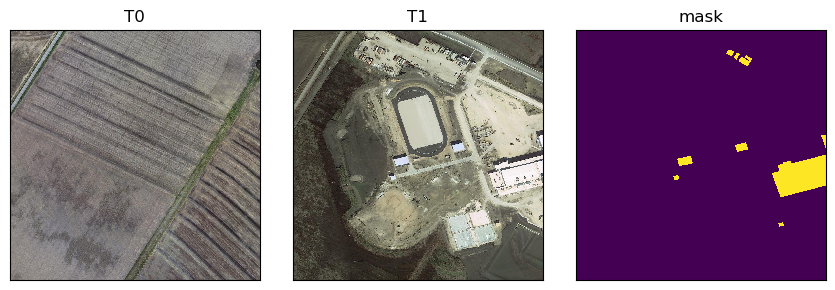

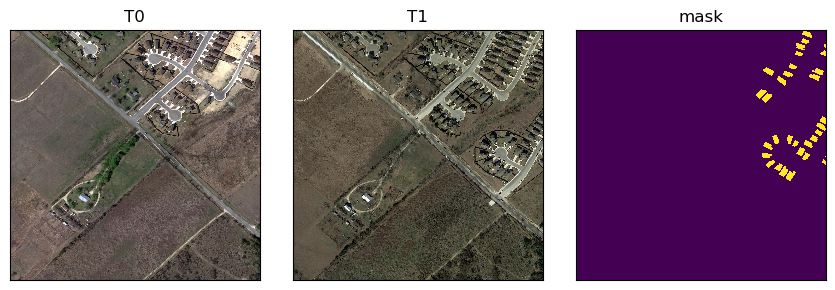

...

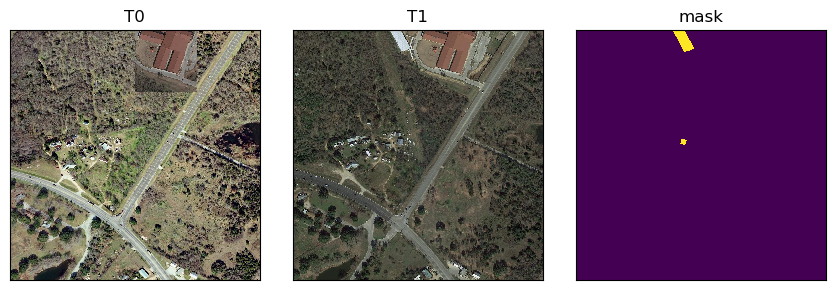

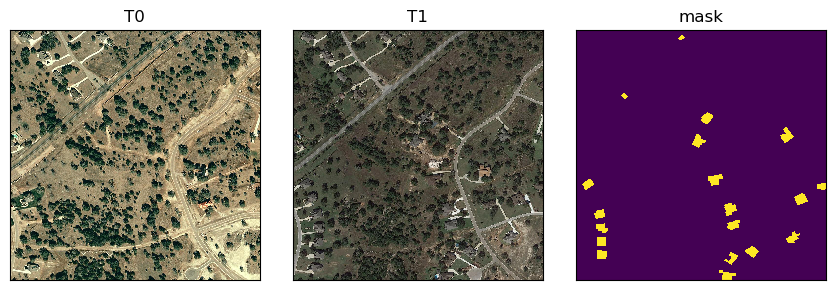

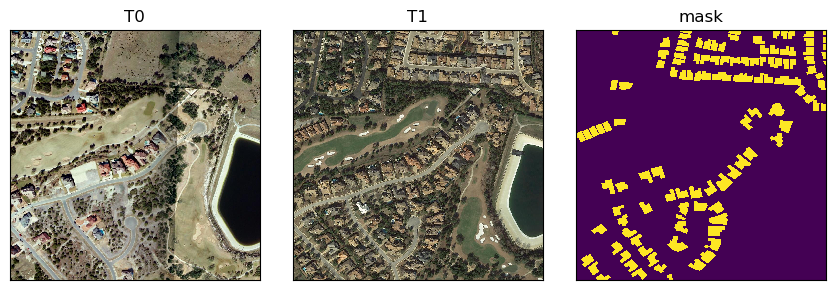

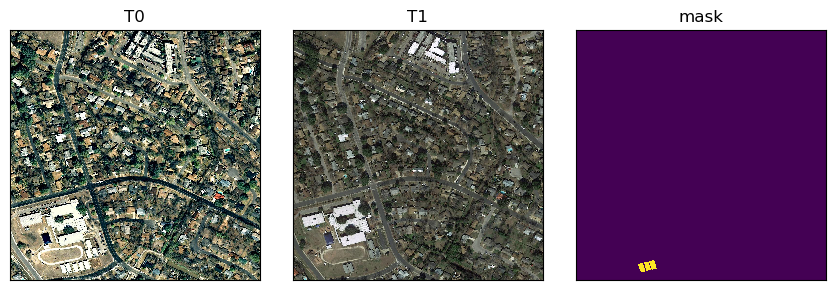

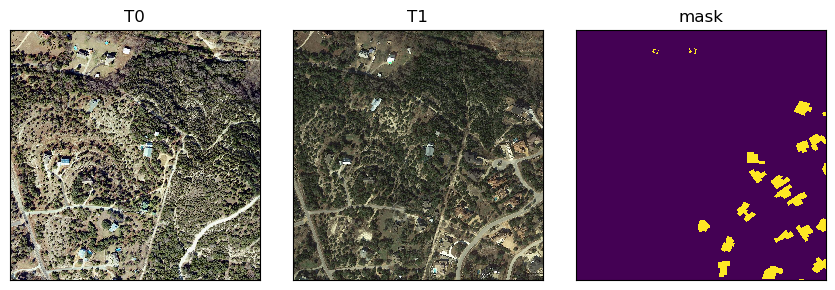

In [11]:
for i in range(len(input.validate.dataset)):
    v = input.validate.dataset[i]
    _ = image_line([v['T0'], v['T1'], v['mask']], ['T0', 'T1', 'mask'])

In [24]:
mask0 = input.validate.dataset[0]['mask']

In [25]:
mask0[mask0.nonzero(as_tuple=True)]

tensor([255, 255, 255,  ..., 255, 255, 255], dtype=torch.uint8)

<IPython.core.display.Javascript object>


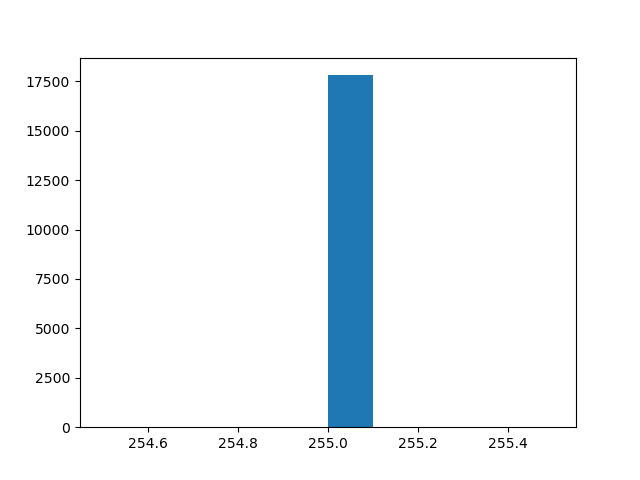

(array([    0.,     0.,     0.,     0.,     0., 17806.,     0.,     0.,
            0.,     0.]),
 array([254.5, 254.6, 254.7, 254.8, 254.9, 255. , 255.1, 255.2, 255.3,
        255.4, 255.5]),
 <BarContainer object of 10 artists>)

In [40]:
import numpy as np 

plt.hist(mask0[np.where(mask0!=0)])